In [1]:
import pandas as pd
import numpy as np
import json
import folium
import re
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from nltk.corpus import stopwords
#hej

In [3]:
!ls

Melbourne
MichelleSiw.github.io
Social Data - Final Project.ipynb
archive


In [4]:
df = pd.read_json('archive\\yelp_academic_dataset_business.json', lines=True)
print(df.shape)

(160585, 14)


In [13]:
df.columns

Index(['business_id', 'name', 'address', 'city', 'state', 'postal_code',
       'latitude', 'longitude', 'stars', 'review_count', 'is_open',
       'attributes', 'categories', 'hours'],
      dtype='object')

In [5]:
df.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,6iYb2HFDywm3zjuRg0shjw,Oskar Blues Taproom,921 Pearl St,Boulder,CO,80302,40.017544,-105.283348,4.0,86,1,"{'RestaurantsTableService': 'True', 'WiFi': 'u...","Gastropubs, Food, Beer Gardens, Restaurants, B...","{'Monday': '11:0-23:0', 'Tuesday': '11:0-23:0'..."
1,tCbdrRPZA0oiIYSmHG3J0w,Flying Elephants at PDX,7000 NE Airport Way,Portland,OR,97218,45.588906,-122.593331,4.0,126,1,"{'RestaurantsTakeOut': 'True', 'RestaurantsAtt...","Salad, Soup, Sandwiches, Delis, Restaurants, C...","{'Monday': '5:0-18:0', 'Tuesday': '5:0-17:0', ..."
2,bvN78flM8NLprQ1a1y5dRg,The Reclaimory,4720 Hawthorne Ave,Portland,OR,97214,45.511907,-122.613693,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Antiques, Fashion, Used, Vintage & Consignment...","{'Thursday': '11:0-18:0', 'Friday': '11:0-18:0..."
3,oaepsyvc0J17qwi8cfrOWg,Great Clips,2566 Enterprise Rd,Orange City,FL,32763,28.914482,-81.295979,3.0,8,1,"{'RestaurantsPriceRange2': '1', 'BusinessAccep...","Beauty & Spas, Hair Salons",None
4,PE9uqAjdw0E4-8mjGl3wVA,Crossfit Terminus,1046 Memorial Dr SE,Atlanta,GA,30316,33.747027,-84.353424,4.0,14,1,"{'GoodForKids': 'False', 'BusinessParking': '{...","Gyms, Active Life, Interval Training Gyms, Fit...","{'Monday': '16:0-19:0', 'Tuesday': '16:0-19:0'..."


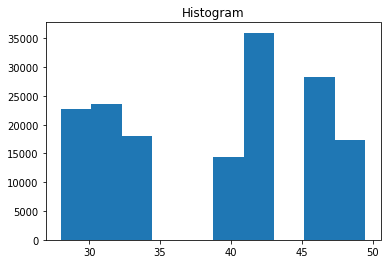

In [21]:
plt.hist(df['latitude']) 
plt.title("Histogram") 
plt.show()

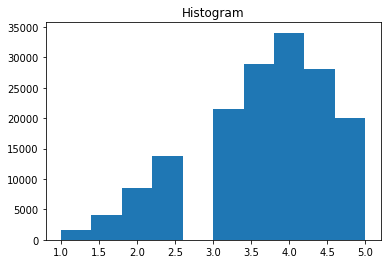

In [19]:
plt.hist(df['stars']) 
plt.title("Histogram") 
plt.show()

In [ ]:
plt.hist(df['stars'],bins=25) 
plt.title("Histogram") 
plt.show()

In [ ]:
plt.hist(df['stars'],bins=25) 
plt.title("Histogram") 
plt.show()

In [6]:
#checking how many nan values there is in the column Categories.
df['categories'].isna().mean()

0.0007161316436778031

In [7]:
df = df[df['categories'].notna()] #take out missing ones
df.shape

(160470, 14)

In [8]:
list_cat = ';'.join(df['categories']) #saveing a list with the different categories.
list_cat_ = re.split(';|,', list_cat) #split and new line
cat_trim = [item.lstrip() for item in list_cat_] #delete the space infront of the words
df_cat = pd.DataFrame(cat_trim, columns=['category']) #save as df

In [9]:
cat_count = df_cat.category.value_counts()
cat_count = cat_count.sort_values(ascending = False)
cat_count = cat_count.iloc[0:10]

C:\Users\Miche\anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


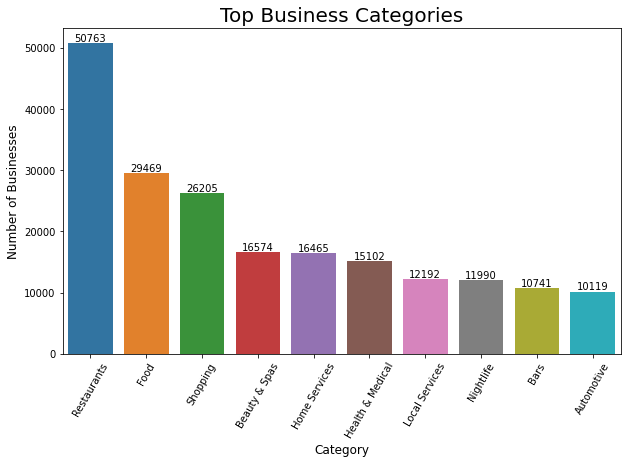

In [10]:
# plot
fig = plt.figure(figsize=(10, 6))
ax = sns.barplot(cat_count.index, cat_count.values)
plt.title("Top Business Categories",fontsize = 20)
x_locs,x_labels = plt.xticks()
plt.setp(x_labels, rotation = 60)
plt.ylabel('Number of Businesses', fontsize = 12)
plt.xlabel('Category', fontsize = 12)

#text labels
r = ax.patches
labels = cat_count.values
for rect, label in zip(r, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 10, label, ha='center', va='bottom')

In [11]:
df_res = df.loc[[i for i in df['categories'].index if re.search('Restaurants', df['categories'][i])]]

In [12]:
df_res.shape

(50763, 14)

In [11]:
map_sanfran = folium.Map(location=[48.1667, -100.1667], zoom_start=2.9)

#for each coordinate, create circlemarker of user percent
for i in range(len(df_res)):
    lat = df_res.iloc[i]['latitude']
    long = df_res.iloc[i]['longitude']
    radius = 2
    
    folium.CircleMarker(location = [lat, long], radius = radius, fill = False, 
                        color = 'red').add_to(map_sanfran)
#show the map
map_sanfran

In [12]:
df_res['city_state'] = df_res['city'] + ',' + df_res['state']

C:\Users\Miche\anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


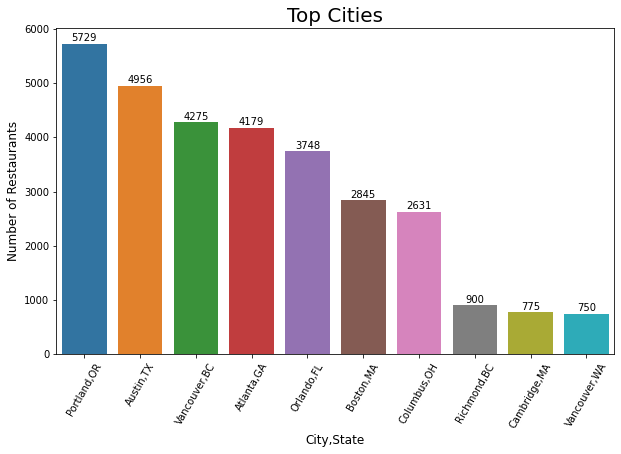

In [13]:
city_res_count = df_res.city_state.value_counts()
city_res_count = city_res_count.sort_values(ascending = False)
city_res_count = city_res_count.iloc[0:10]

# plot
fig = plt.figure(figsize=(10, 6))
ax = sns.barplot(city_res_count.index, city_res_count.values)
plt.title("Top Cities",fontsize = 20)
x_locs,x_labels = plt.xticks()
plt.setp(x_labels, rotation = 60)
plt.ylabel('Number of Restaurants', fontsize = 12)
plt.xlabel('City,State', fontsize = 12)

#text labels
r = ax.patches
labels = city_res_count.values
for rect, label in zip(r, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 10, label, ha='center', va='bottom')

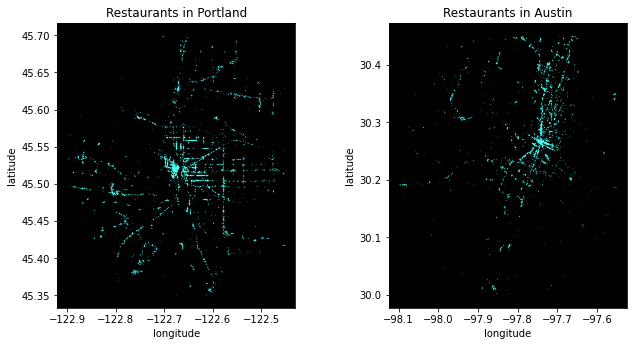

In [14]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,6))

#coordinates for Portland (Source: Google)
lat_t = 45.512794
lon_t =  -122.679565

#rectangular view
lon_t_min, lon_t_max = lon_t-0.5,lon_t+0.5
lat_t_min, lat_t_max = lat_t-0.5,lat_t+0.5

#subset the data
df_res_tor=df_res[(df_res["longitude"]>lon_t_min) & (df_res["longitude"]<lon_t_max) &\
                    (df_res["latitude"]>lat_t_min) & (df_res["latitude"]<lat_t_max)]

#plot
df_res_tor.plot(kind='scatter', x='longitude', y='latitude',
                color='#52fff3', s=0.02, alpha=.6, subplots=True, ax=ax1)
ax1.set_title("Restaurants in Portland")
ax1.set_facecolor('black')

#coordinates for Austin, TX(Source: Google)
lat_v = 30.266666
lon_v = -97.733330

#rectangular view
lon_v_min, lon_v_max = lon_v-0.5,lon_v+0.5
lat_v_min, lat_v_max = lat_v-0.5,lat_v+0.5

#subset the data
df_res_lv=df_res[(df_res["longitude"]>lon_v_min) & (df_res["longitude"]<lon_v_max) &\
                    (df_res["latitude"]>lat_v_min) & (df_res["latitude"]<lat_v_max)]

#plot
df_res_lv.plot(kind='scatter', x='longitude', y='latitude',
                color='#52fff3', s=.02, alpha=.6, subplots=True, ax=ax2)
ax2.set_title("Restaurants in Austin")
ax2.set_facecolor('black')

f.tight_layout(pad=5.0);

C:\Users\Miche\anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


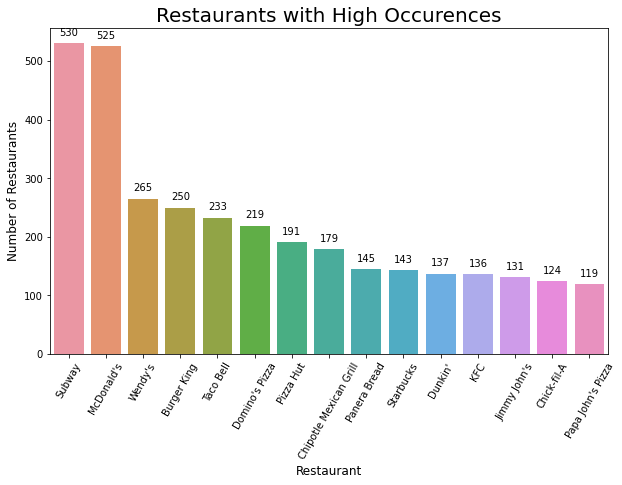

In [15]:
res_count = df_res.name.value_counts()
res_count = res_count.sort_values(ascending = False)
res_count = res_count.iloc[0:15]

# plot
fig = plt.figure(figsize=(10, 6))
ax = sns.barplot(res_count.index, res_count.values)
plt.title("Restaurants with High Occurences",fontsize = 20)
x_locs,x_labels = plt.xticks()
plt.setp(x_labels, rotation = 60)
plt.ylabel('Number of Restaurants', fontsize = 12)
plt.xlabel('Restaurant', fontsize = 12)

#text labels
r = ax.patches
labels = res_count.values
for rect, label in zip(r, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 10, label, ha='center', va='bottom')

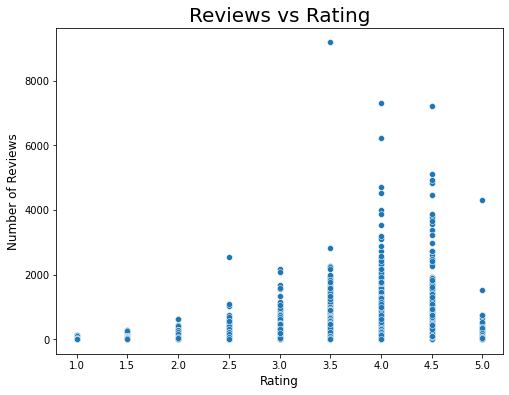

In [16]:
fig = plt.figure(figsize=(8, 6))
sns.scatterplot(x = 'stars', y = 'review_count', data = df_res)
plt.title("Reviews vs Rating",fontsize = 20)
plt.ylabel('Number of Reviews', fontsize = 12)
plt.xlabel('Rating', fontsize = 12);

Attribute

In [17]:
df_res['attributes'] = df_res['attributes'].apply(lambda x: {} if x is None else x)
df_att = pd.json_normalize(df_res.attributes)

In [18]:
#attributes for each restaurant
df_att.columns

Index(['RestaurantsTableService', 'WiFi', 'BikeParking', 'BusinessParking',
       'BusinessAcceptsCreditCards', 'RestaurantsReservations',
       'WheelchairAccessible', 'Caters', 'OutdoorSeating',
       'RestaurantsGoodForGroups', 'HappyHour', 'BusinessAcceptsBitcoin',
       'RestaurantsPriceRange2', 'Ambience', 'HasTV', 'Alcohol', 'GoodForMeal',
       'DogsAllowed', 'RestaurantsTakeOut', 'NoiseLevel', 'RestaurantsAttire',
       'RestaurantsDelivery', 'GoodForKids', 'ByAppointmentOnly', 'Music',
       'GoodForDancing', 'BestNights', 'BYOB', 'CoatCheck', 'Smoking',
       'DriveThru', 'BYOBCorkage', 'Corkage', 'RestaurantsCounterService',
       'DietaryRestrictions', 'AgesAllowed', 'Open24Hours', 'AcceptsInsurance',
       'HairSpecializesIn'],
      dtype='object')

In [19]:
df_att.RestaurantsTableService.value_counts()

True     11231
False     7958
None         9
Name: RestaurantsTableService, dtype: int64

In [20]:
# calculates the freq. between RestaurantsPriceRange2 and CoatCheck
pd.crosstab(df_att.RestaurantsPriceRange2, 
            df_att.CoatCheck, margins=True, normalize = 'index')

CoatCheck,False,None,True
RestaurantsPriceRange2,,,
1,0.978641,0.000000,0.021359
2,0.944885,0.000344,0.054771
3,0.537367,0.000000,0.462633
4,0.371429,0.000000,0.628571
All,0.913498,0.000268,0.086235


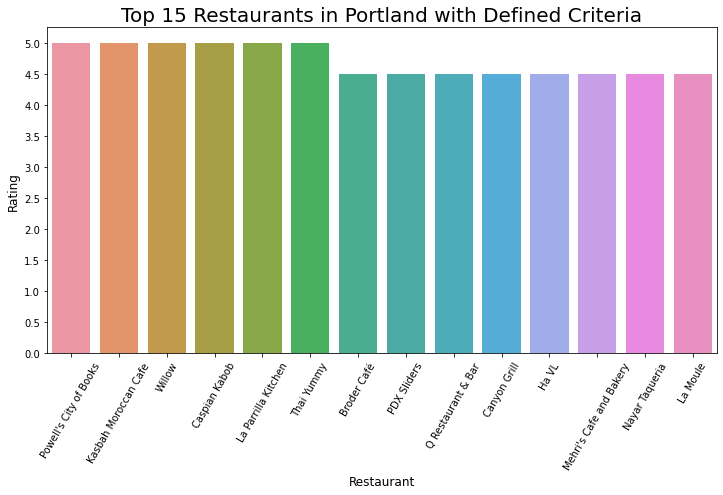

In [33]:
df_port = df_res.loc[df_res['city'] == 'Portland']

# open restaurants more than 100 reviews with rating above 3.5, accepts takeout, credit cards, and price range of $$.
crit = (df_port['stars'] > 3.5) & (df_port['review_count'] > 100) & (df_port['is_open'] == 1) & (df_att.RestaurantsTakeOut == 'True') & (df_att.RestaurantsPriceRange2 == '2') & (df_att.BusinessAcceptsCreditCards == 'True')
df_port_sub = df_port.loc[crit]
fig = plt.figure(figsize=(12, 6))
sns.barplot(x = 'name', y = 'stars', data = df_port_sub.sort_values(by=['stars', 'review_count'], ascending = False)[0:15])
plt.title("Top 15 Restaurants in Portland with Defined Criteria",fontsize = 20)
x_locs,x_labels = plt.xticks()
plt.setp(x_labels, rotation = 60)
plt.yticks(np.arange(0.0, 5.5, 0.5))
plt.ylabel('Rating', fontsize = 12)
plt.xlabel('Restaurant', fontsize = 12);

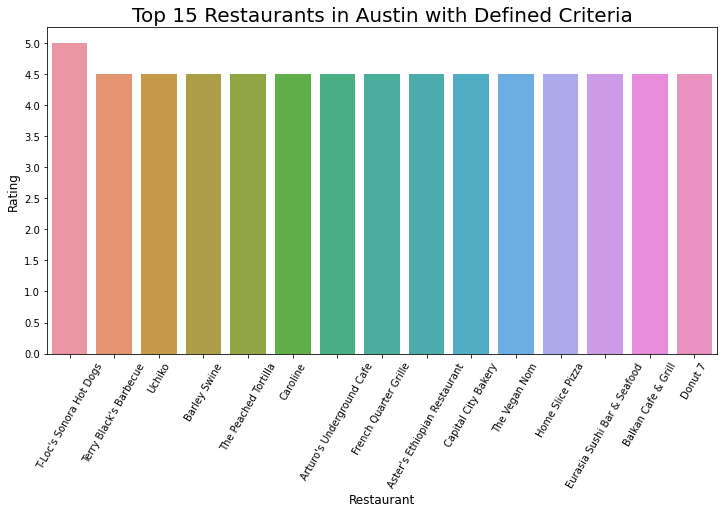

In [37]:
df_port = df_res.loc[df_res['city'] == 'Austin']

# open restaurants more than 100 reviews with rating above 3.5, accepts takeout, credit cards, and price range of $$.
crit = (df_port['stars'] > 3.5) & (df_port['review_count'] > 100) & (df_port['is_open'] == 1) & (df_att.RestaurantsTakeOut == 'True') & (df_att.RestaurantsPriceRange2 == '2') & (df_att.BusinessAcceptsCreditCards == 'True')
df_port_sub = df_port.loc[crit]
fig = plt.figure(figsize=(12, 6))
sns.barplot(x = 'name', y = 'stars', data = df_port_sub.sort_values(by=['stars', 'review_count'], ascending = False)[0:15])
plt.title("Top 15 Restaurants in Austin with Defined Criteria",fontsize = 20)
x_locs,x_labels = plt.xticks()
plt.setp(x_labels, rotation = 60)
plt.yticks(np.arange(0.0, 5.5, 0.5))
plt.ylabel('Rating', fontsize = 12)
plt.xlabel('Restaurant', fontsize = 12);

Look at Willow and tips data.

In [22]:
df_tip = pd.read_json('archive\\yelp_academic_dataset_tip.json', lines=True)

In [36]:
print(df_tip.date.min(), df_tip.date.max())

2009-04-16 03:04:32 2021-01-28 14:20:15


In [23]:
df_RI = df_res.loc[(df_res['name'] == 'Thai Yummy') & crit] #crit is defined above
df_RI_tips = df_tip.loc[df_tip['business_id'].isin(df_RI.business_id)]

In [24]:
df_RI_tips.shape

(17, 5)

Process text

In [25]:
def text_prep(text):
    # filer out non-letters and lowercase them
    text = re.sub('[^a-z\s]', '', text.lower())
    # remove stopwords
    text = [w for w in text.split() if w not in stopwords.words('english')]
    return ' '.join(text)

In [26]:
pd.set_option('mode.chained_assignment', None)
df_RI_tips['text_cl'] = df_RI_tips['text'].apply(text_prep)

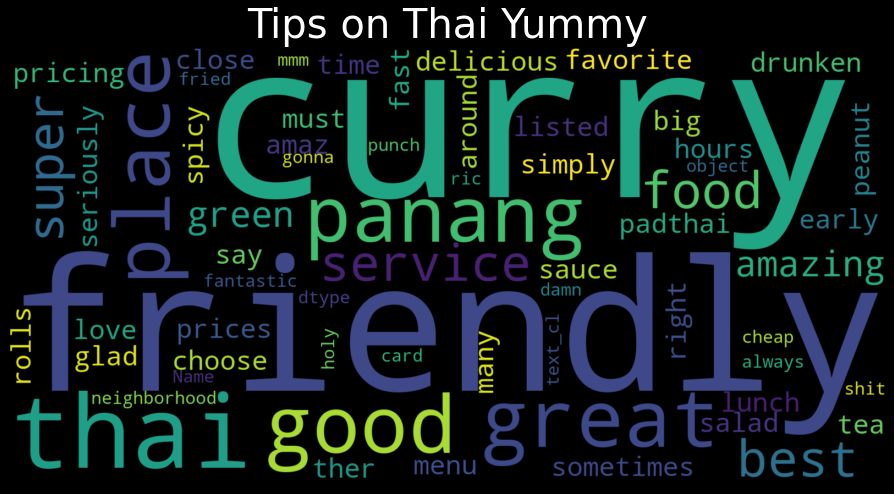

In [28]:
wc = WordCloud(width=1600, height=800, random_state=42, max_words=1000000)

# generation
wc.generate(str(df_RI_tips['text_cl']))

plt.figure(figsize=(15,10), facecolor='black')
plt.title("Tips on Thai Yummy", fontsize=40, color='white')
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.tight_layout(pad=10)

In [31]:
df_FFC = df_res.loc[(df_res['name'] == 'Canyon Grill') & crit]
df_FFC_tips = df_tip.loc[df_tip['business_id'].isin(df_FFC.business_id)]

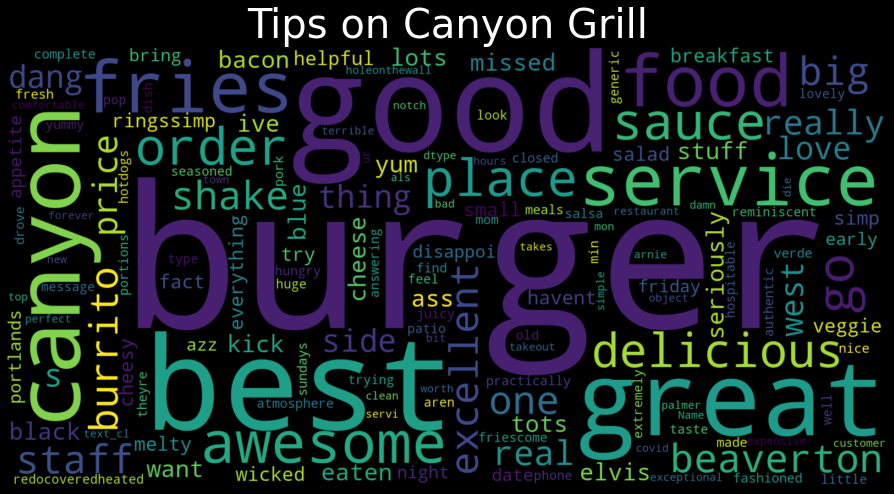

In [32]:
df_FFC_tips['text_cl'] = df_FFC_tips['text'].apply(text_prep)

wc = WordCloud(width=1600, height=800, random_state=42, max_words=20000)

# generation
wc.generate(str(df_FFC_tips['text_cl']))

plt.figure(figsize=(15,10), facecolor='black')
plt.title("Tips on Canyon Grill", fontsize=40, color='white')
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.tight_layout(pad=10)

In [38]:
df_FFC = df_res.loc[(df_res['name'] == 'Caroline') & crit]
df_FFC_tips = df_tip.loc[df_tip['business_id'].isin(df_FFC.business_id)]

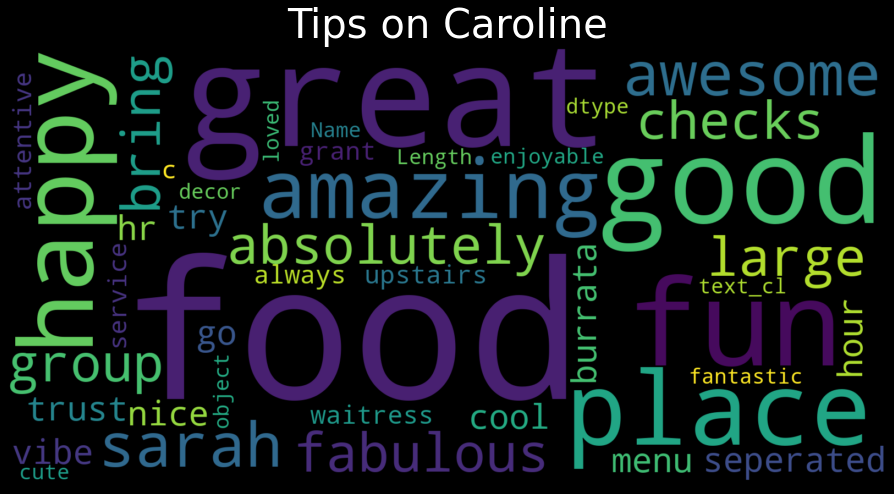

In [39]:
df_FFC_tips['text_cl'] = df_FFC_tips['text'].apply(text_prep)

wc = WordCloud(width=1600, height=800, random_state=42, max_words=20000)

# generation
wc.generate(str(df_FFC_tips['text_cl']))

plt.figure(figsize=(15,10), facecolor='black')
plt.title("Tips on Caroline", fontsize=40, color='white')
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.tight_layout(pad=10)

In [ ]:
plt.hist(df['Y'],bins=25) 
plt.title("Histogram") 
plt.show()